C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_13188\419075951.py:34: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522039.m4a (sr=44100) ===


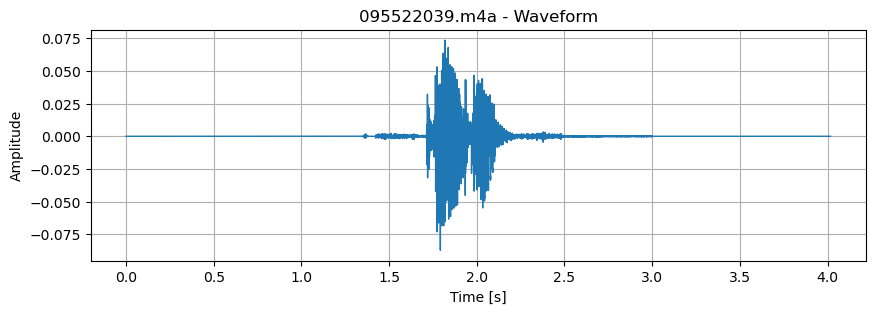

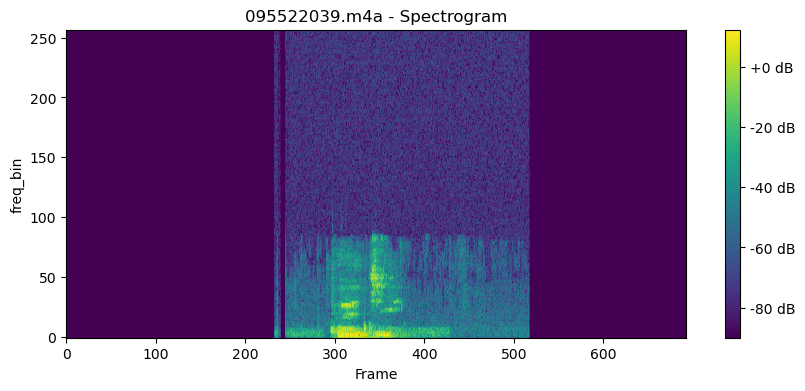

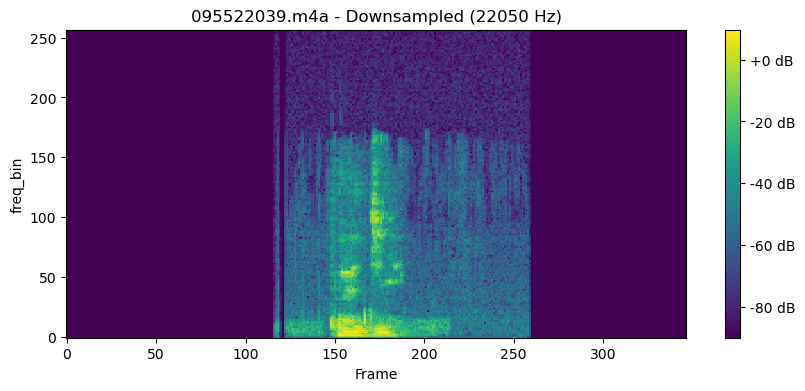

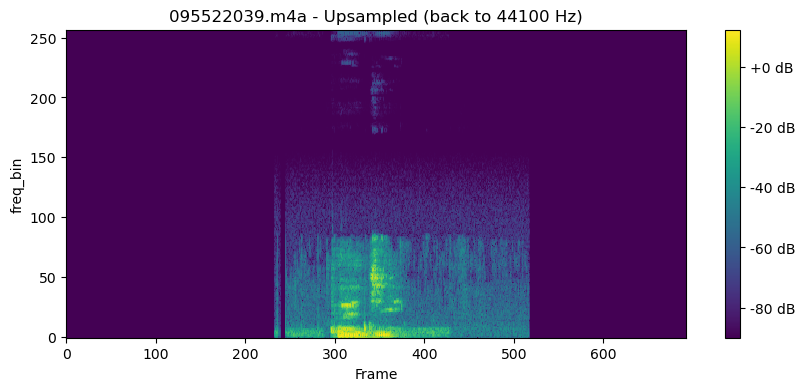

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_13188\419075951.py:34: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522040.m4a (sr=44100) ===


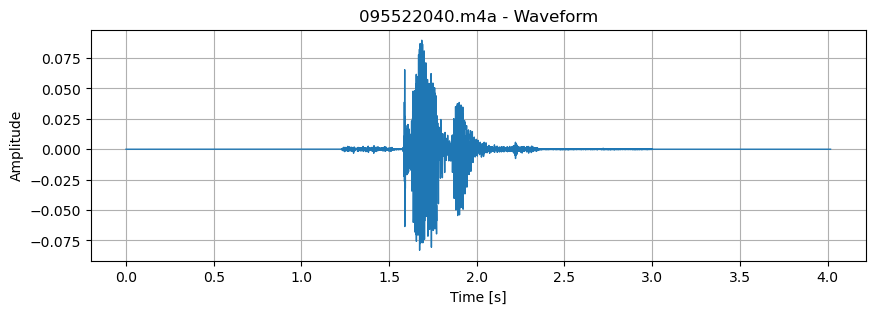

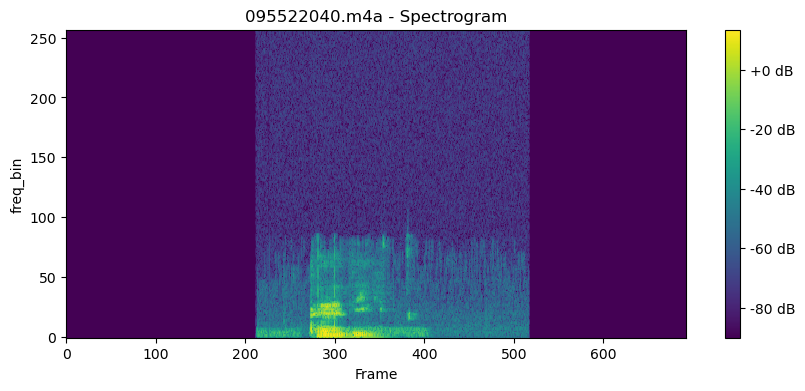

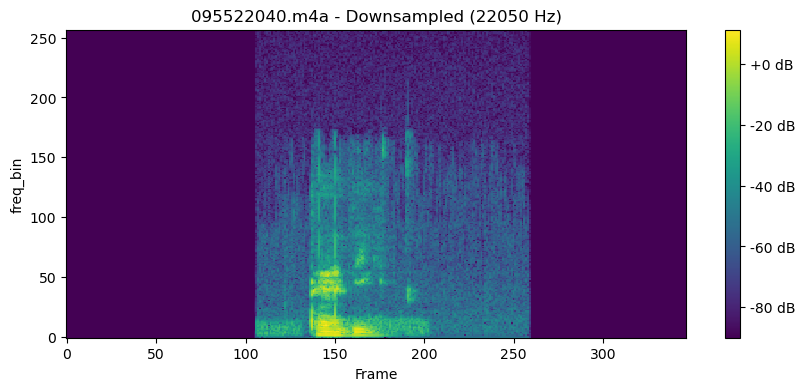

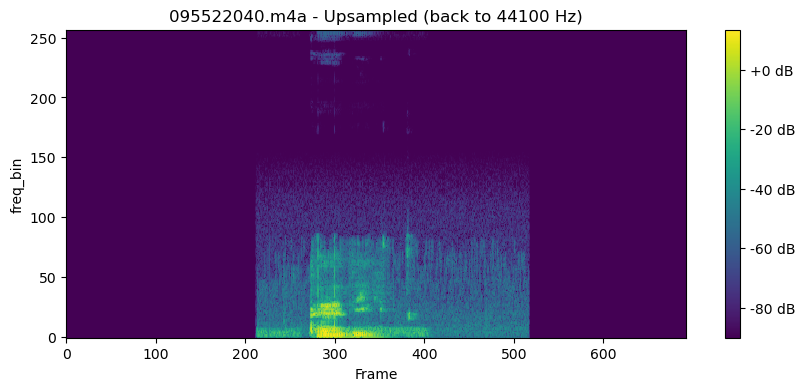


=== 095522041.m4a (sr=44100) ===


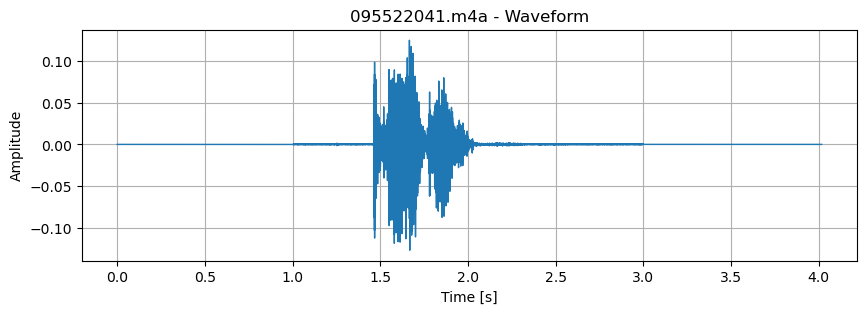

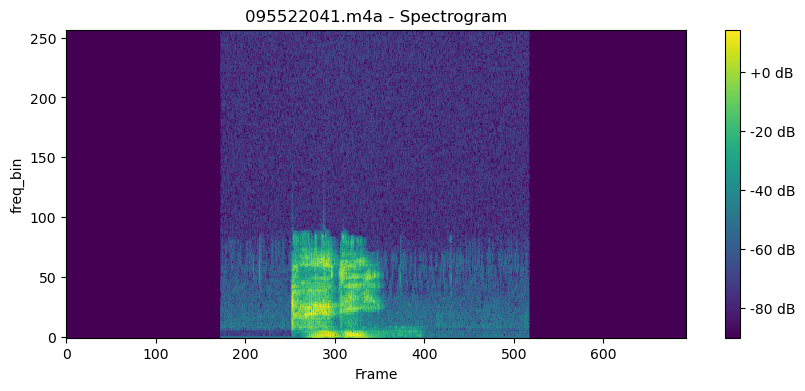

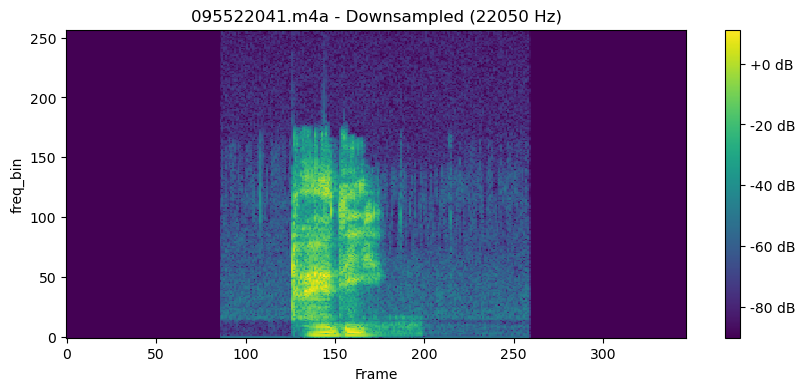

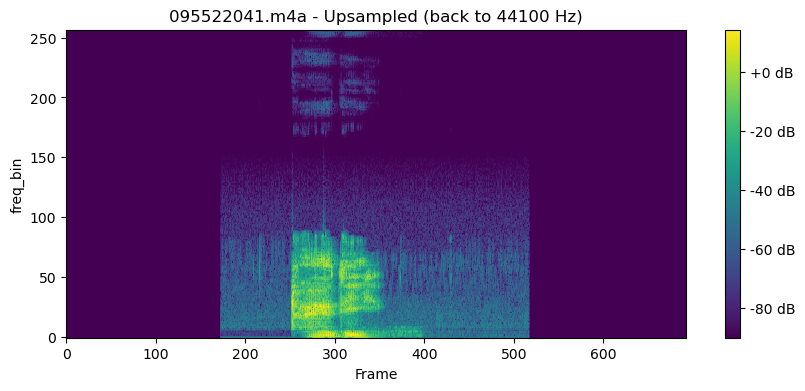


=== 095522042.m4a (sr=44100) ===


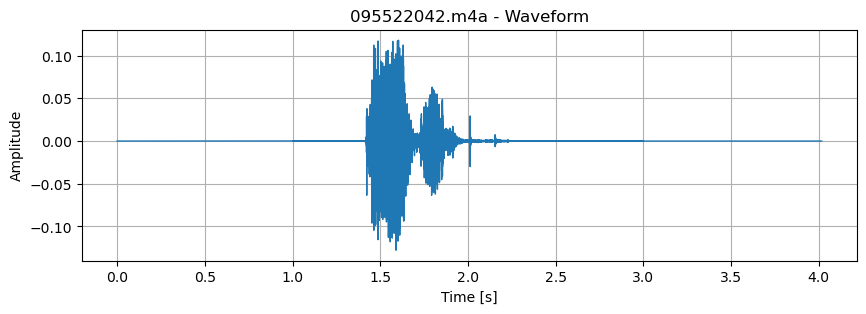

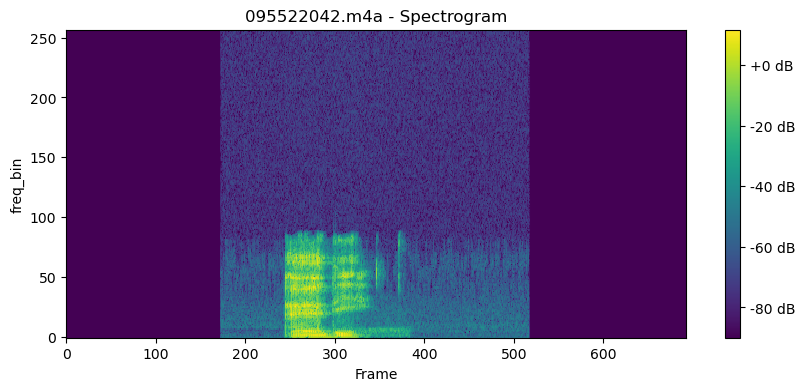

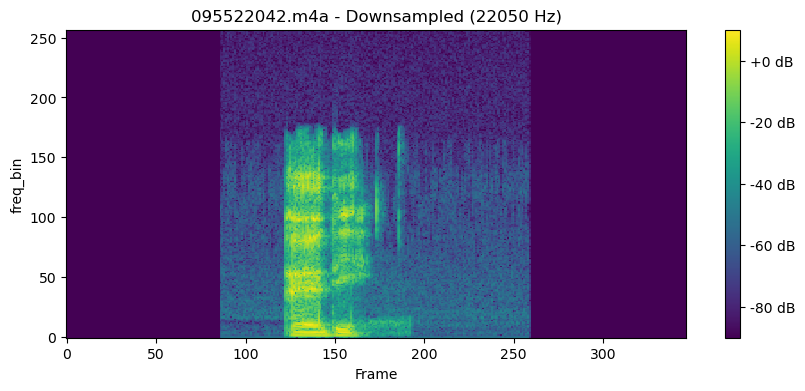

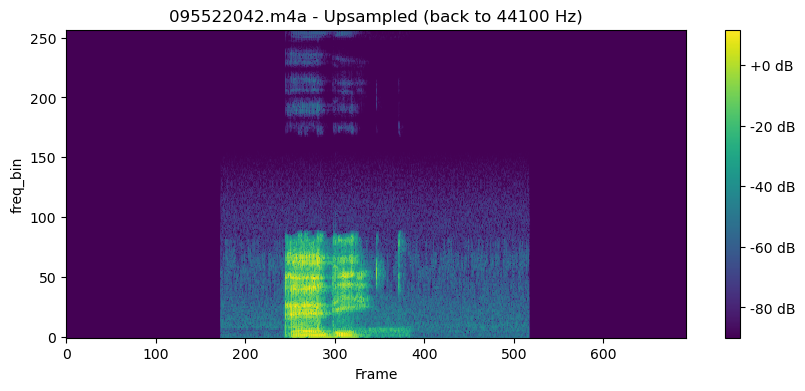

In [ ]:
# Assignment 1 Reference: https://docs.pytorch.org/audio/stable/tutorials/audio_resampling_tutorial.html
import torch, librosa
import torchaudio.transforms as T
import torchaudio.functional as F
import matplotlib.pyplot as plt
from IPython.display import Audio

def plot_waveform(waveform, sr, title="Waveform"):
    t = torch.arange(waveform.shape[-1]) / sr
    plt.figure(figsize=(10,3))
    plt.plot(t, waveform[0].numpy(), linewidth=1)
    plt.title(title)
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.show()

def plot_spectrogram(spec, title="Spectrogram", ylabel="freq_bin"):
    plt.figure(figsize=(10,4))
    plt.imshow(10*torch.log10(spec+1e-9).numpy(), origin="lower", aspect="auto", interpolation="nearest")
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel("Frame")
    plt.colorbar(format="%+2.0f dB")
    plt.show()

DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  # Files 039 ~ 042


for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    print(f"\n=== {f} (sr={sample_rate}) ===")

    # 1) Waveform & Spectrogram
    plot_waveform(waveform, sample_rate, title=f"{f} - Waveform")
    spec = T.Spectrogram(n_fft=512)(waveform)
    plot_spectrogram(spec[0], title=f"{f} - Spectrogram")
    display(Audio(waveform.numpy()[0], rate=sample_rate))

    # 2) Downsampling 
    down = F.resample(waveform, sample_rate, sample_rate//2)
    spec_down = T.Spectrogram(n_fft=512)(down)
    plot_spectrogram(spec_down[0], title=f"{f} - Downsampled ({sample_rate//2} Hz)")
    display(Audio(down.numpy()[0], rate=sample_rate//2))

    # 3) Upsampling 
    up = F.resample(down, sample_rate//2, sample_rate)
    spec_up = T.Spectrogram(n_fft=512)(up)
    plot_spectrogram(spec_up[0], title=f"{f} - Upsampled (back to {sample_rate} Hz)")
    display(Audio(up.numpy()[0], rate=sample_rate))


In [ ]:
# Practicing example code
import torch
import torchaudio
import torchaudio.functional as F
import torchaudio.transforms as T

print(torch.__version__)
print(torchaudio.__version__)

In [ ]:
import math
import timeit

import librosa
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import pandas as pd
import resampy
from IPython.display import Audio

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

DEFAULT_OFFSET = 201


def _get_log_freq(sample_rate, max_sweep_rate, offset):
    """Get freqs evenly spaced out in log-scale, between [0, max_sweep_rate // 2]

    offset is used to avoid negative infinity `log(offset + x)`.

    """
    start, stop = math.log(offset), math.log(offset + max_sweep_rate // 2)
    return torch.exp(torch.linspace(start, stop, sample_rate, dtype=torch.double)) - offset


def _get_inverse_log_freq(freq, sample_rate, offset):
    """Find the time where the given frequency is given by _get_log_freq"""
    half = sample_rate // 2
    return sample_rate * (math.log(1 + freq / offset) / math.log(1 + half / offset))


def _get_freq_ticks(sample_rate, offset, f_max):
    # Given the original sample rate used for generating the sweep,
    # find the x-axis value where the log-scale major frequency values fall in
    times, freq = [], []
    for exp in range(2, 5):
        for v in range(1, 10):
            f = v * 10**exp
            if f < sample_rate // 2:
                t = _get_inverse_log_freq(f, sample_rate, offset) / sample_rate
                times.append(t)
                freq.append(f)
    t_max = _get_inverse_log_freq(f_max, sample_rate, offset) / sample_rate
    times.append(t_max)
    freq.append(f_max)
    return times, freq


def get_sine_sweep(sample_rate, offset=DEFAULT_OFFSET):
    max_sweep_rate = sample_rate
    freq = _get_log_freq(sample_rate, max_sweep_rate, offset)
    delta = 2 * math.pi * freq / sample_rate
    cummulative = torch.cumsum(delta, dim=0)
    signal = torch.sin(cummulative).unsqueeze(dim=0)
    return signal


def plot_sweep(
    waveform,
    sample_rate,
    title,
    max_sweep_rate=48000,
    offset=DEFAULT_OFFSET,
):
    x_ticks = [100, 500, 1000, 5000, 10000, 20000, max_sweep_rate // 2]
    y_ticks = [1000, 5000, 10000, 20000, sample_rate // 2]

    time, freq = _get_freq_ticks(max_sweep_rate, offset, sample_rate // 2)
    freq_x = [f if f in x_ticks and f <= max_sweep_rate // 2 else None for f in freq]
    freq_y = [f for f in freq if f in y_ticks and 1000 <= f <= sample_rate // 2]

    figure, axis = plt.subplots(1, 1)
    _, _, _, cax = axis.specgram(waveform[0].numpy(), Fs=sample_rate)
    plt.xticks(time, freq_x)
    plt.yticks(freq_y, freq_y)
    axis.set_xlabel("Original Signal Frequency (Hz, log scale)")
    axis.set_ylabel("Waveform Frequency (Hz)")
    axis.xaxis.grid(True, alpha=0.67)
    axis.yaxis.grid(True, alpha=0.67)
    figure.suptitle(f"{title} (sample rate: {sample_rate} Hz)")
    plt.colorbar(cax)
    
   
def plot_sweep_real(waveform, sample_rate, title="Waveform Spectrogram (Real Audio)"):
    figure, axis = plt.subplots(1, 1)
    _, _, _, cax = axis.specgram(
        waveform[0].numpy(),
        Fs=sample_rate,
        NFFT=1024,
        noverlap=512,
        detrend='constant',  
        scale_by_freq=True,
        mode="psd",
    )
    axis.set_xlabel("Time (s)")
    axis.set_ylabel("Frequency (Hz)")
    axis.xaxis.grid(True, alpha=0.67)
    axis.yaxis.grid(True, alpha=0.67)
    figure.suptitle(f"{title} (sample rate: {sample_rate} Hz)")
    plt.colorbar(cax)



C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\2379336619.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(path, sr=None, mono=True)


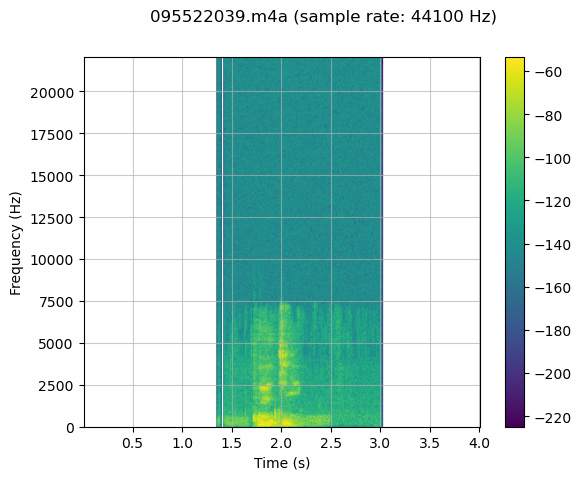

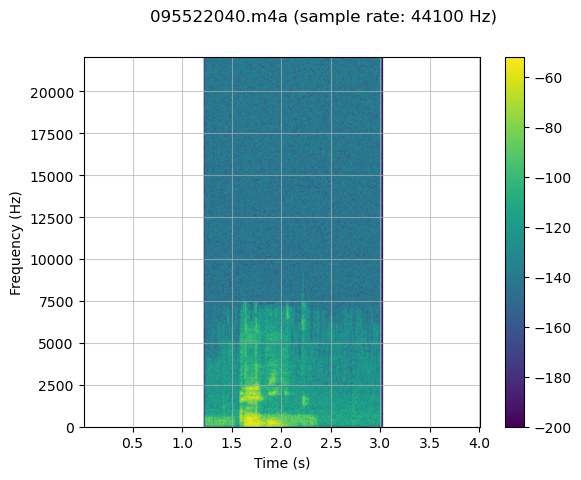

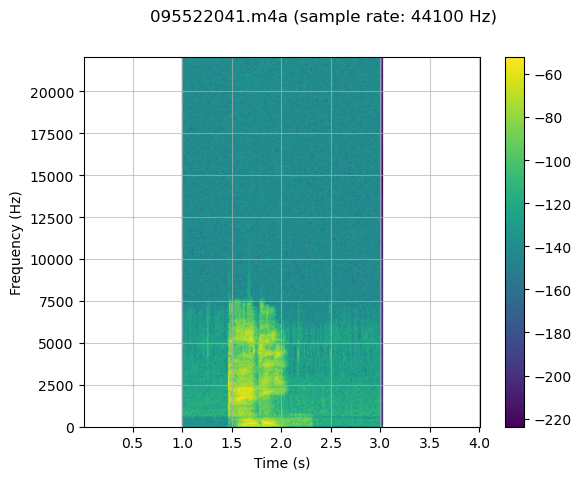

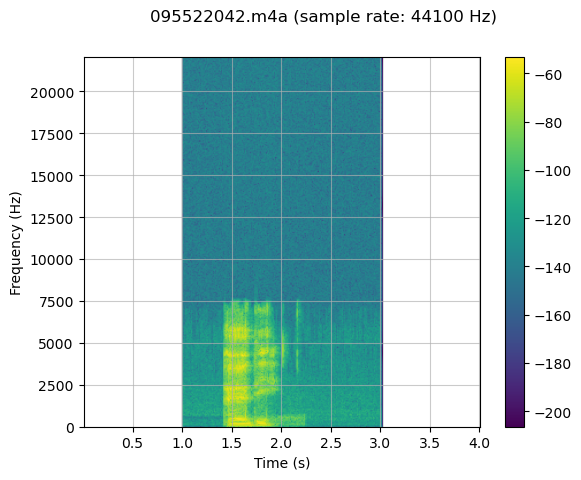

In [ ]:

FILES = [f"0955220{i}.m4a" for i in range(39, 43)]


for f in FILES:
    path = fr"{DATA}\{f}"  
    
  
    y, sr = librosa.load(path, sr=None, mono=True)
    
    waveform = torch.from_numpy(y).unsqueeze(0)
    
   
    plot_sweep_real(waveform, sr, title=f)
 
    display(Audio(waveform.numpy()[0], rate=sr))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1056697760.py:7: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


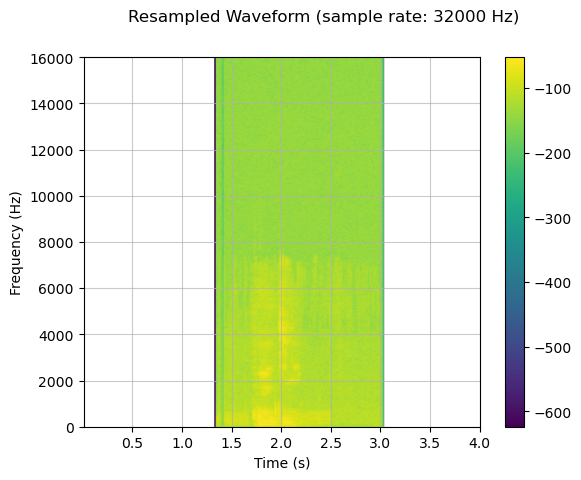

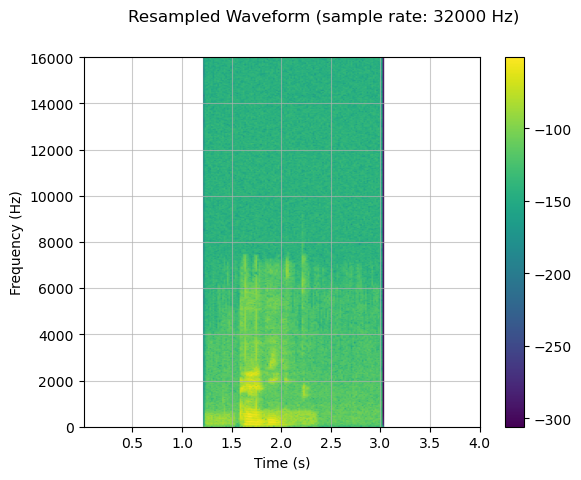

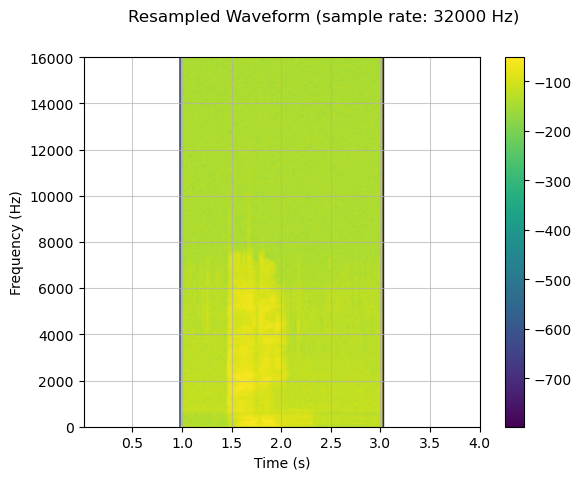

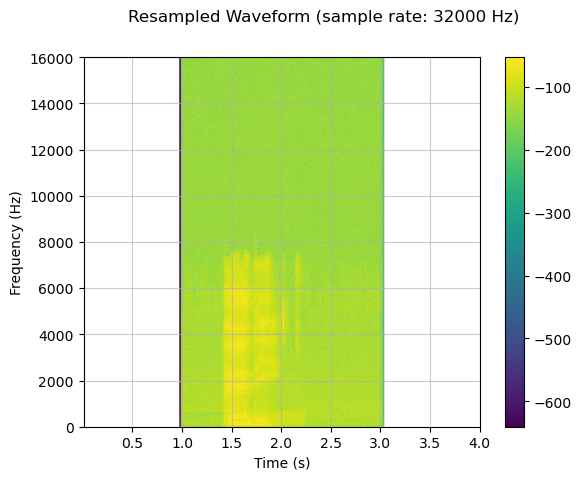

In [ ]:

DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    resampler = T.Resample(sample_rate, resample_rate, dtype=waveform.dtype)
    resampled_waveform = resampler(waveform)

    plot_sweep_real(resampled_waveform, resample_rate, title="Resampled Waveform")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1500419886.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


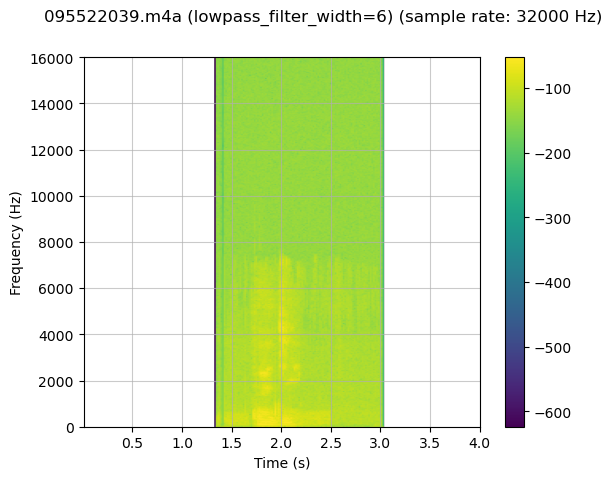

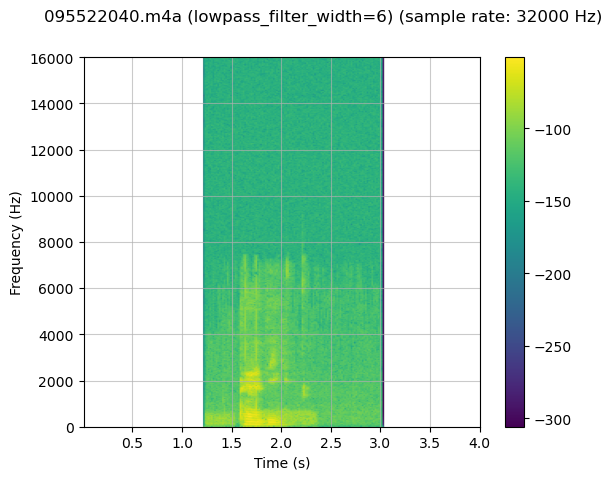

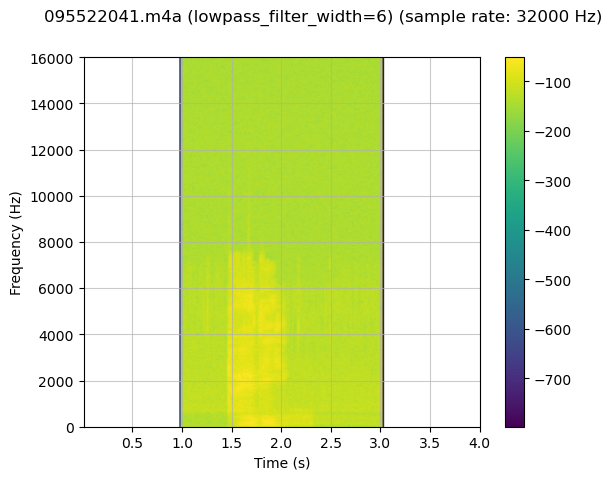

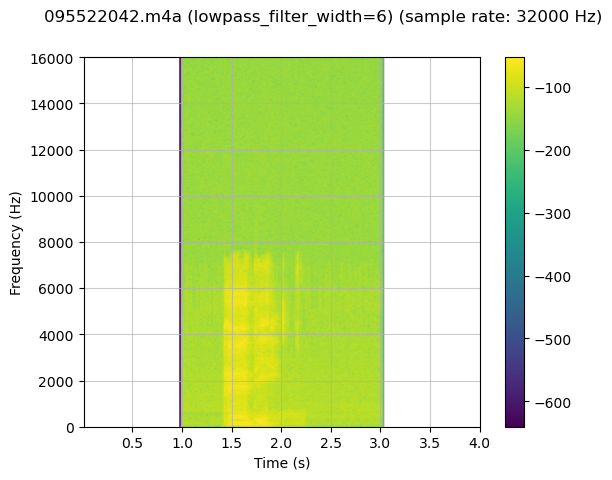

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, lowpass_filter_width=6
    )

    
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (lowpass_filter_width=6)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1388435265.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


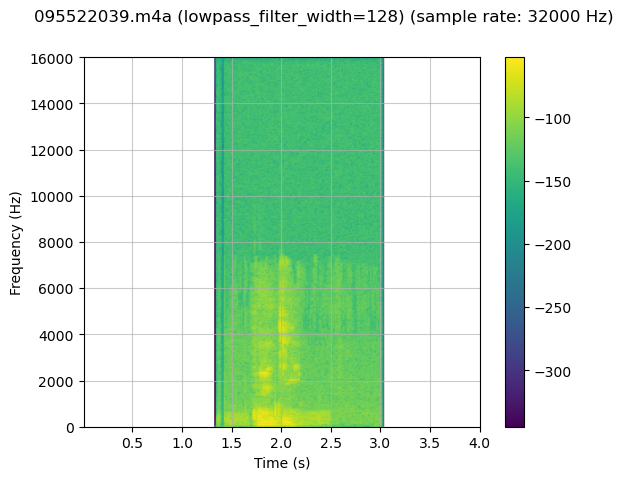

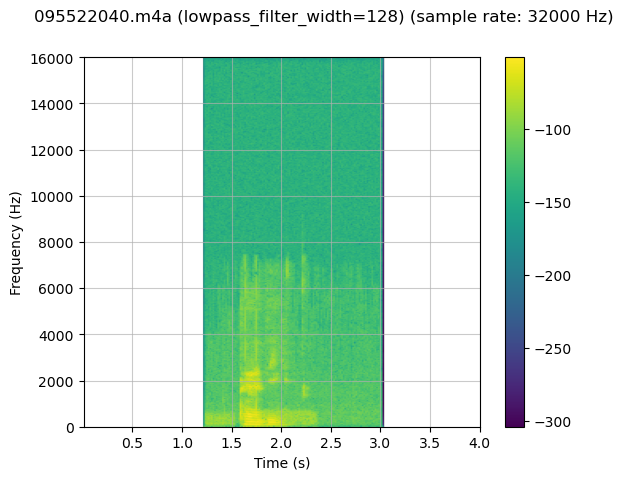

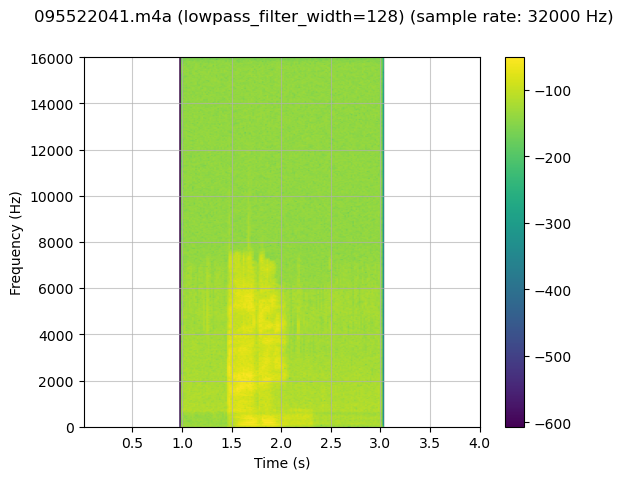

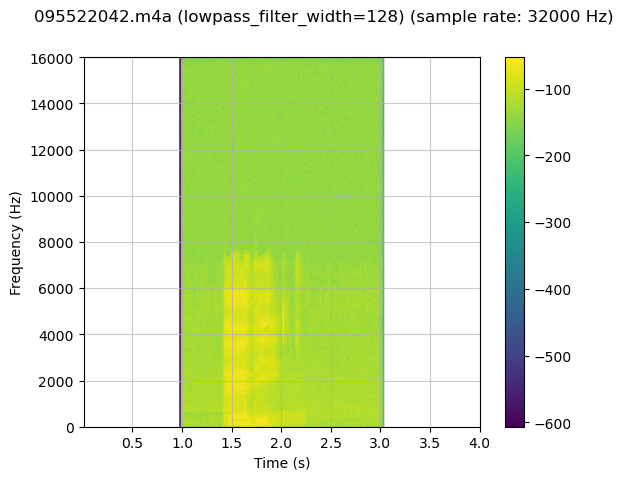

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, lowpass_filter_width=128
    )

    
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (lowpass_filter_width=128)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\979350645.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


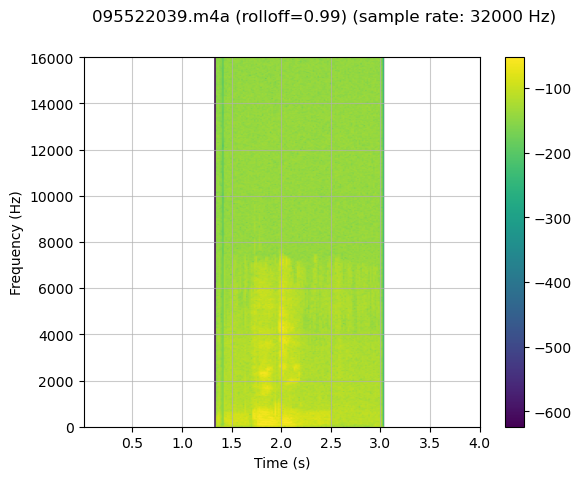

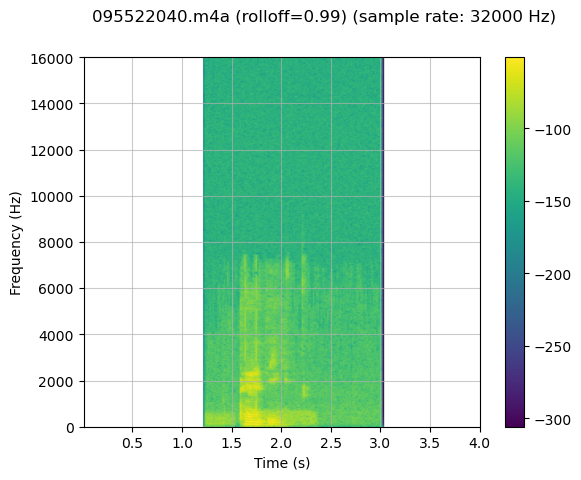

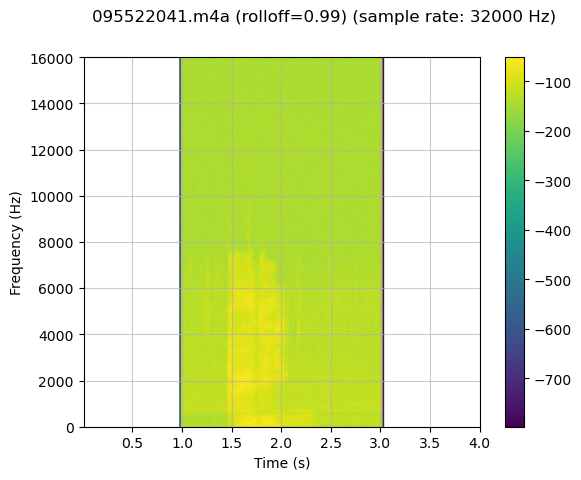

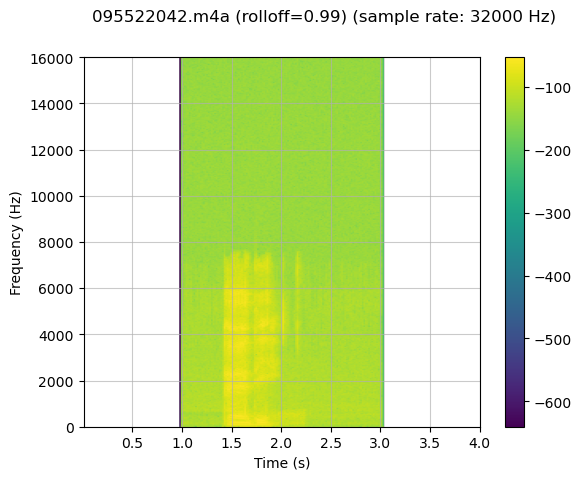

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000

    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, rolloff=0.99
    )

   
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (rolloff=0.99)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\755533739.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
c:\Users\user\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


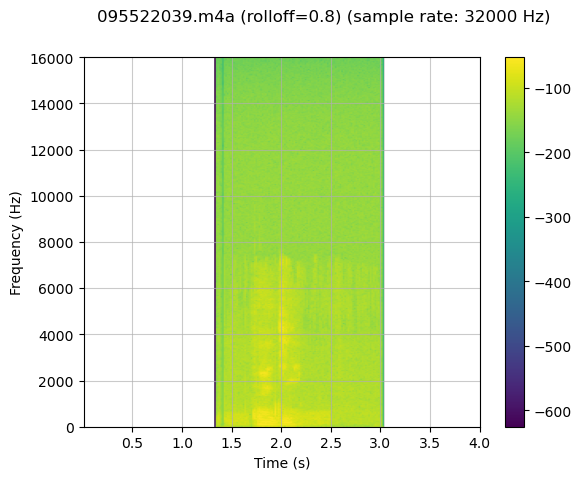

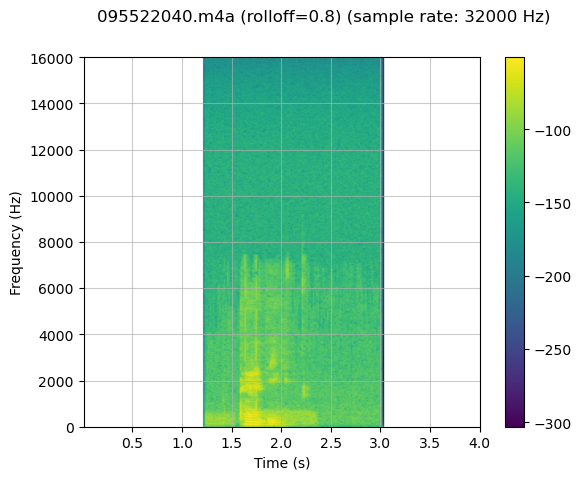

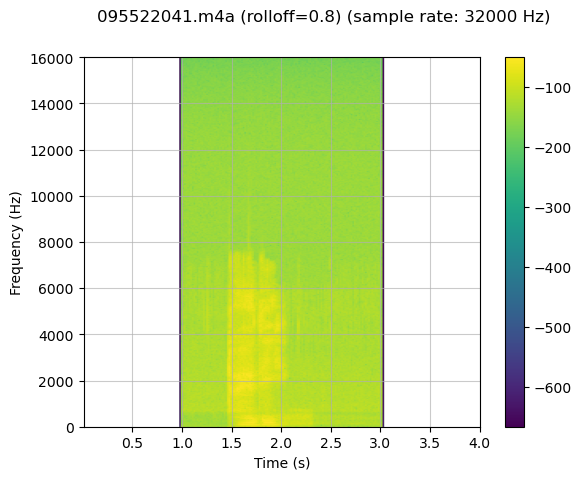

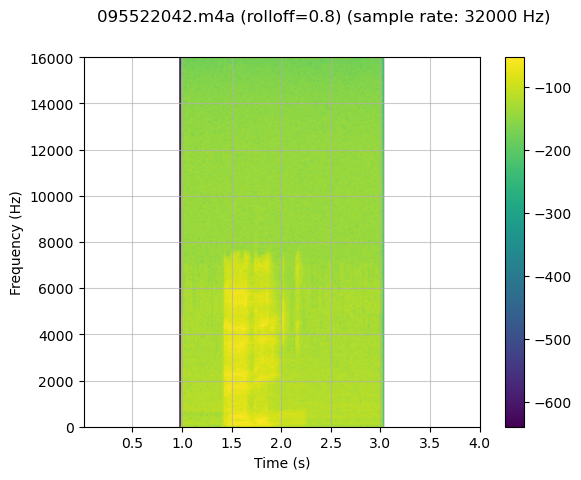

In [50]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
   
    resampled_waveform = F.resample(
        waveform, sample_rate, resample_rate, rolloff=0.8
    )

   
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (rolloff=0.8)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\4027158867.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


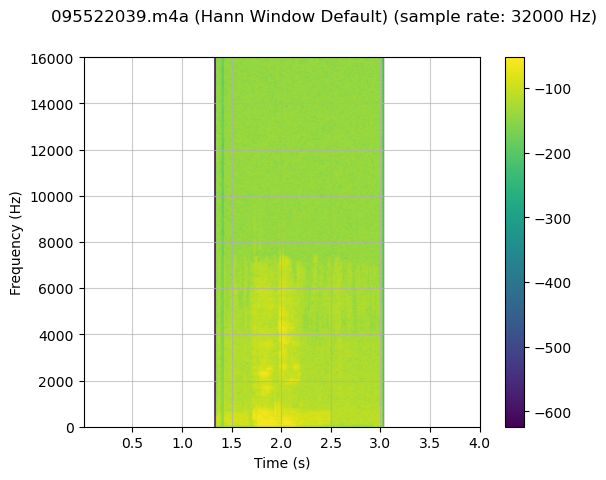

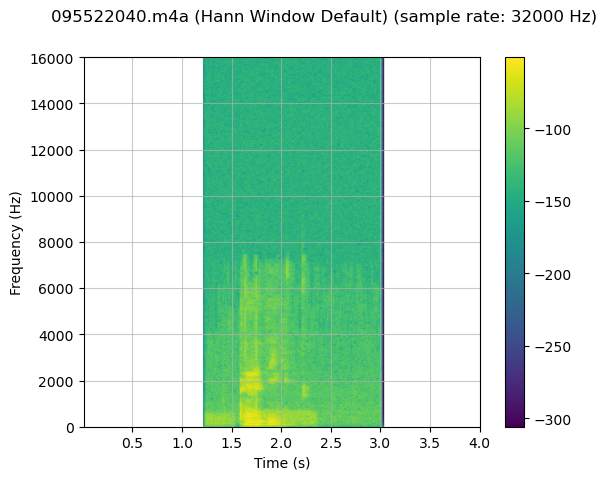

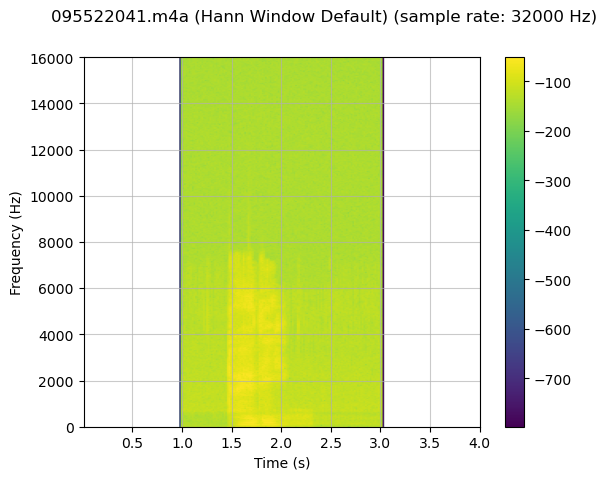

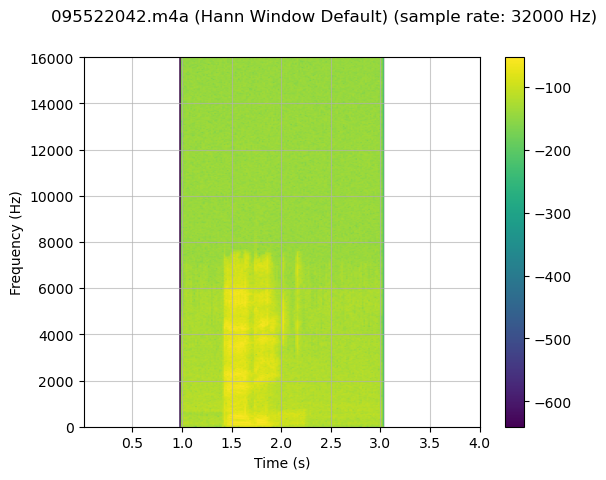

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 
for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
  
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        resampling_method="sinc_interp_hann"
    )

    
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (Hann Window Default)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\3714430306.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


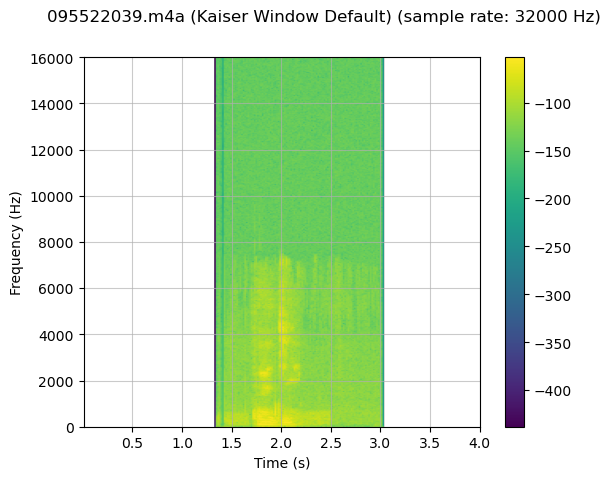

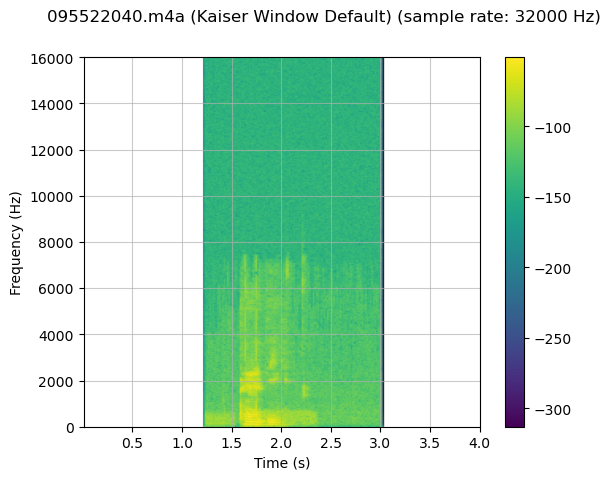

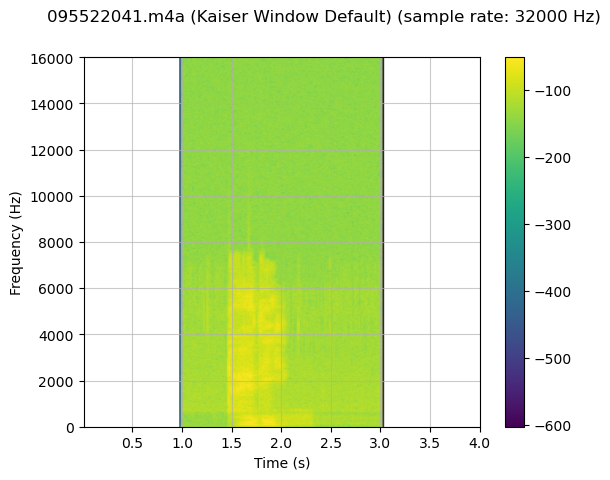

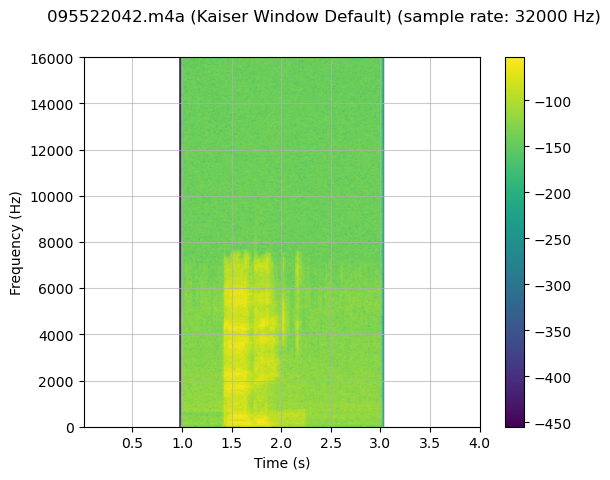

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 
for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        resampling_method="sinc_interp_kaiser"
    )

   
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (Kaiser Window Default)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\3686874599.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


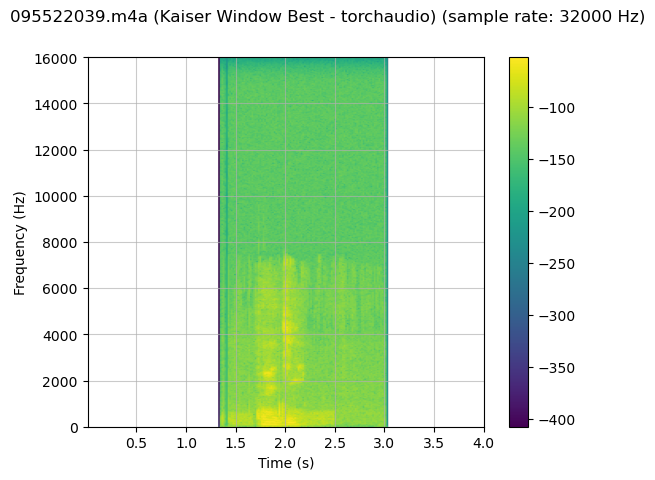

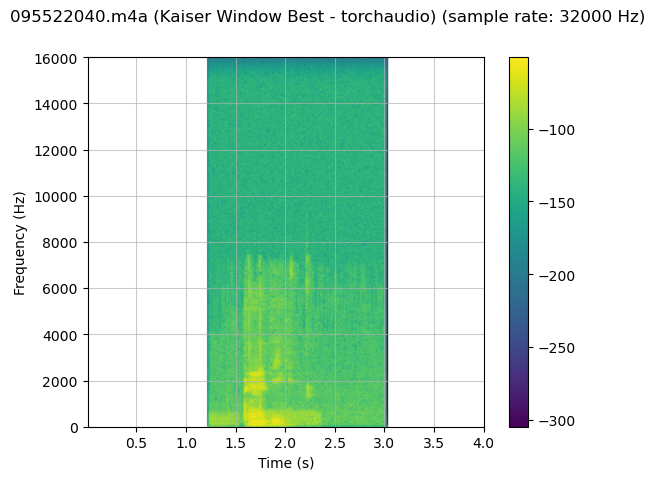

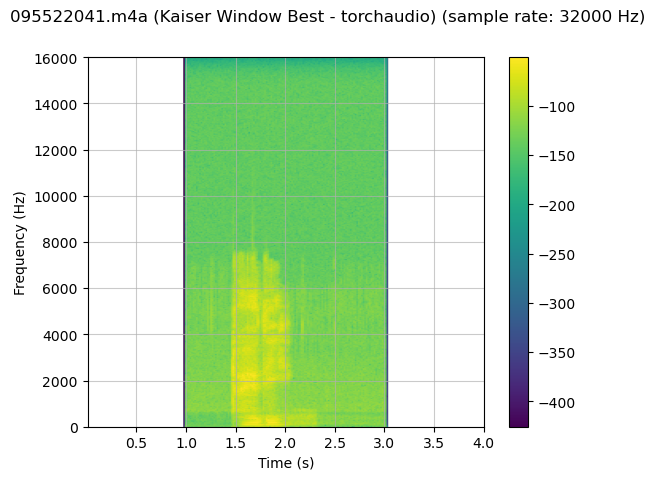

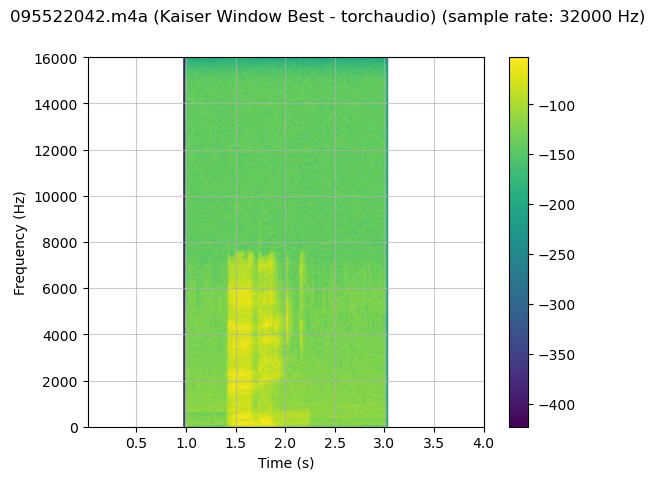

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=64,
        rolloff=0.9475937167399596,
        resampling_method="sinc_interp_kaiser",
        beta=14.769656459379492,
    )

    
    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (Kaiser Window Best - torchaudio)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\5974807.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\5974807.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


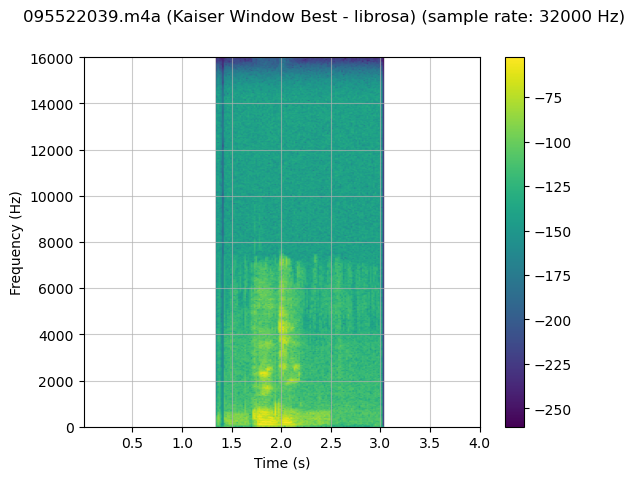

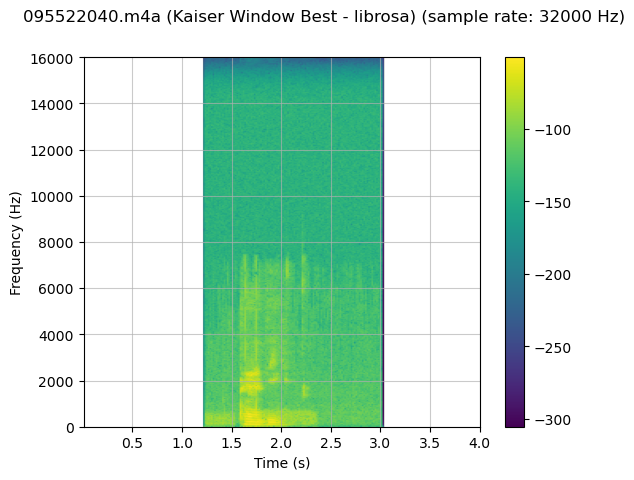

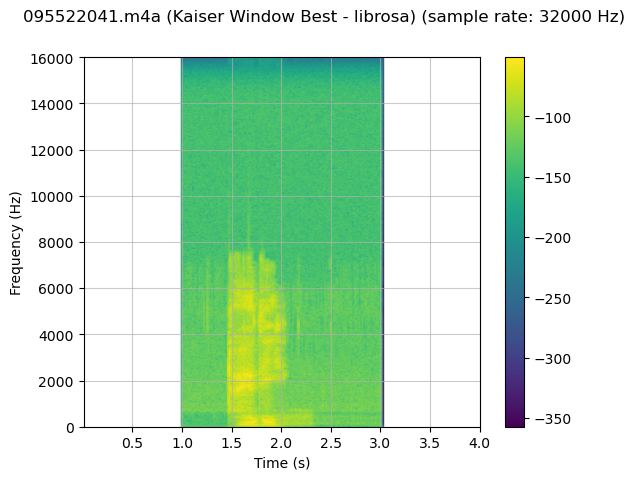

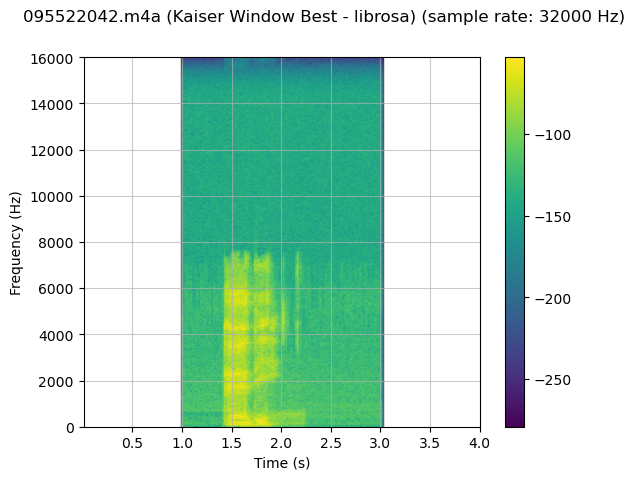

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    librosa_resampled_waveform = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_best"
        )
    ).unsqueeze(0)

   
    plot_sweep_real(librosa_resampled_waveform, resample_rate,
                    title=f"{f} (Kaiser Window Best - librosa)")
    display(Audio(librosa_resampled_waveform.numpy()[0], rate=resample_rate))


In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000

    torchaudio_resampled = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=64,
        rolloff=0.9475937167399596,
        resampling_method="sinc_interp_kaiser",
        beta=14.769656459379492,
    )

    librosa_resampled = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_best"
        )
    ).unsqueeze(0)


    mse = torch.square(torchaudio_resampled - librosa_resampled).mean().item()
    print(f"{f} → torchaudio vs librosa kaiser_best MSE: {mse:.6e}")


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\2947140776.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


095522039.m4a → torchaudio vs librosa kaiser_best MSE: 9.394557e-13
095522040.m4a → torchaudio vs librosa kaiser_best MSE: 1.019389e-12
095522041.m4a → torchaudio vs librosa kaiser_best MSE: 1.210689e-12
095522042.m4a → torchaudio vs librosa kaiser_best MSE: 1.226972e-12


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\771442676.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
c:\Users\user\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


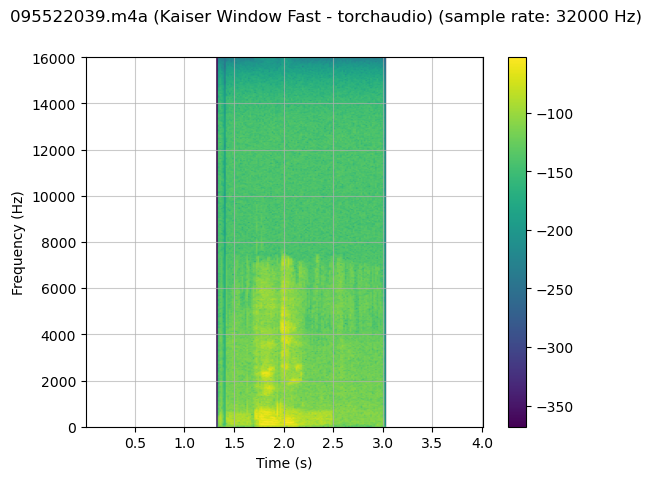

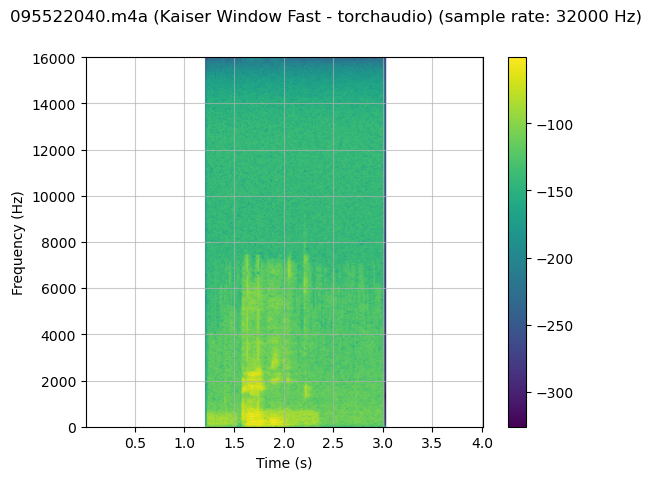

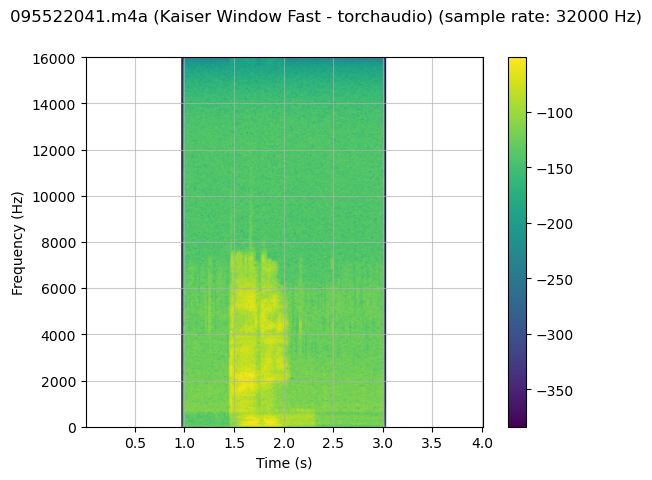

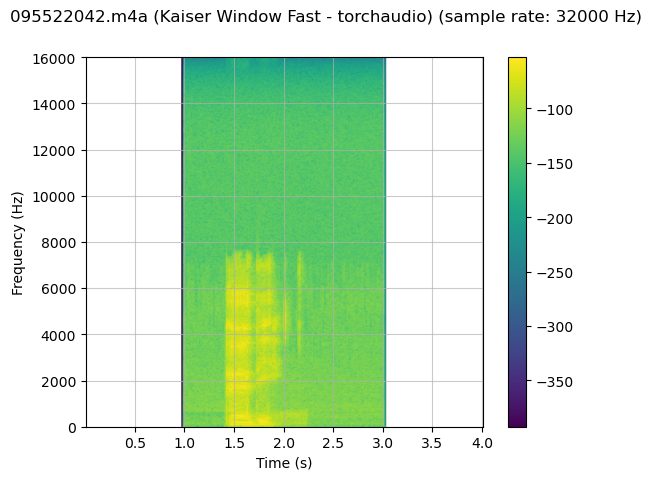

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    resampled_waveform = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=16,
        rolloff=0.85,
        resampling_method="sinc_interp_kaiser",
        beta=8.555504641634386,
    )

    plot_sweep_real(resampled_waveform, resample_rate,
                    title=f"{f} (Kaiser Window Fast - torchaudio)")
    display(Audio(resampled_waveform.numpy()[0], rate=resample_rate))


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\4154577240.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


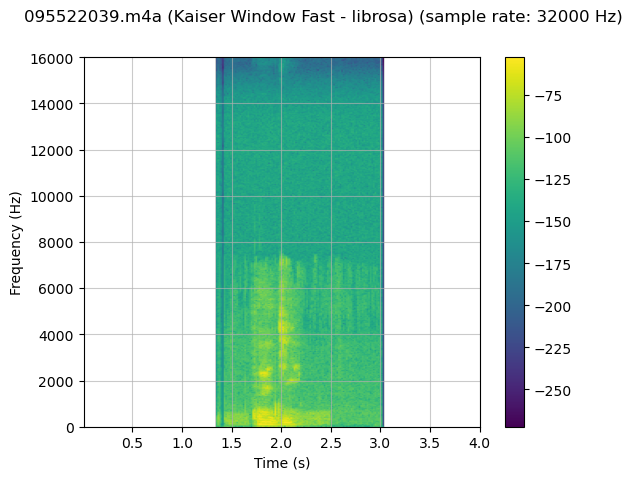

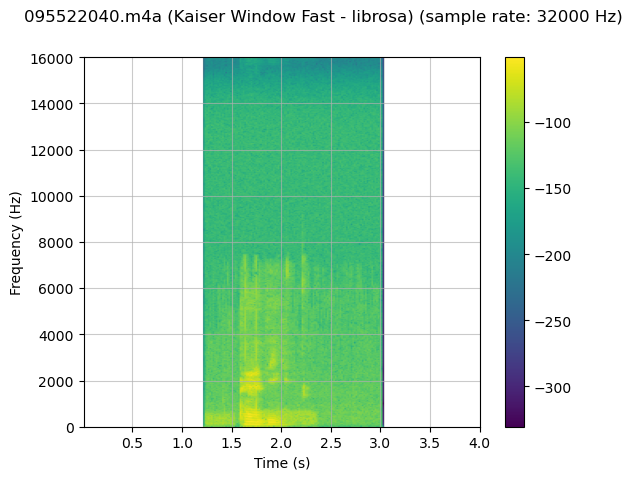

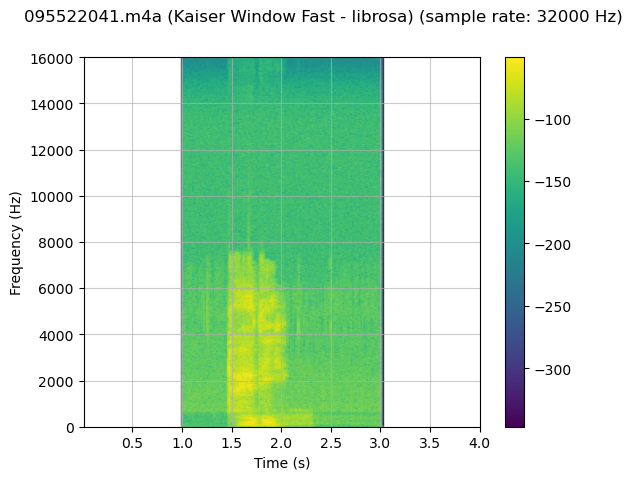

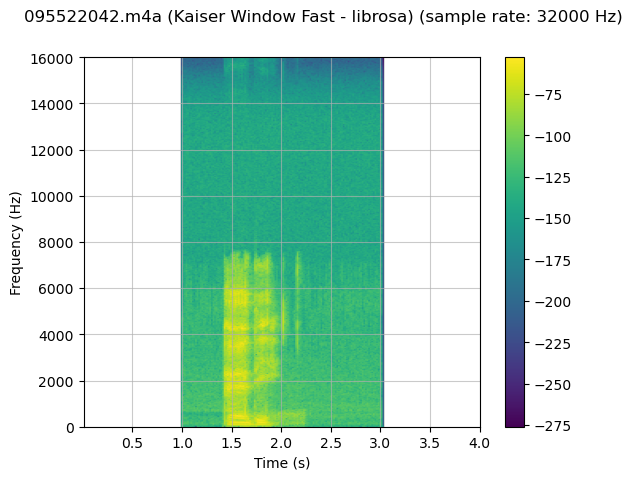

In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]  

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000
    
    librosa_resampled_waveform = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_fast"
        )
    ).unsqueeze(0)

 
    plot_sweep_real(librosa_resampled_waveform, resample_rate,
                    title=f"{f} (Kaiser Window Fast - librosa)")
    display(Audio(librosa_resampled_waveform.numpy()[0], rate=resample_rate))


In [ ]:
DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)] 

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sample_rate = librosa.load(path, sr=None, mono=True)
    waveform = torch.from_numpy(y).unsqueeze(0)

    resample_rate = 32000

    
    torchaudio_resampled = F.resample(
        waveform,
        sample_rate,
        resample_rate,
        lowpass_filter_width=16,
        rolloff=0.85,
        resampling_method="sinc_interp_kaiser",
        beta=8.555504641634386,
    )

    librosa_resampled = torch.from_numpy(
        librosa.resample(
            waveform.squeeze().numpy(),
            orig_sr=sample_rate,
            target_sr=resample_rate,
            res_type="kaiser_fast"
        )
    ).unsqueeze(0)

    mse = torch.square(torchaudio_resampled - librosa_resampled).mean().item()
    print(f"{f} → torchaudio vs librosa kaiser_fast MSE: {mse:.6e}")


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\2119094694.py:6: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sample_rate = librosa.load(path, sr=None, mono=True)


095522039.m4a → torchaudio vs librosa kaiser_fast MSE: 9.739011e-12
095522040.m4a → torchaudio vs librosa kaiser_fast MSE: 1.226000e-11
095522041.m4a → torchaudio vs librosa kaiser_fast MSE: 2.255223e-11
095522042.m4a → torchaudio vs librosa kaiser_fast MSE: 2.316279e-11


In [48]:
print(f"torchaudio: {torchaudio.__version__}")
print(f"librosa: {librosa.__version__}")
print(f"resampy: {resampy.__version__}")

torchaudio: 2.8.0+cpu
librosa: 0.11.0
resampy: 0.4.3


C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1270757799.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(path, sr=None, mono=True)



=== 095522039.m4a (orig_sr=44100, target_sr=32000) ===
                 librosa  functional  transforms
sinc (width 64)      NaN        1.94        1.06
sinc (width 16)      NaN        1.75        0.85
kaiser_best       130.23        8.68        2.43
kaiser_fast        35.31        3.42        1.01


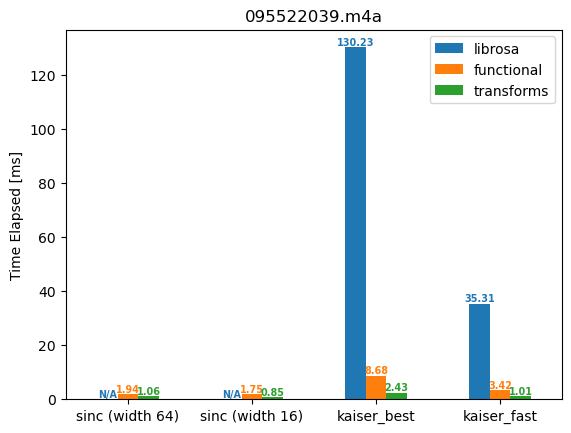

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1270757799.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522040.m4a (orig_sr=44100, target_sr=32000) ===
                 librosa  functional  transforms
sinc (width 64)      NaN        1.69        0.77
sinc (width 16)      NaN        1.61        0.77
kaiser_best       142.78        4.64        1.02
kaiser_fast        35.78        3.28        0.82


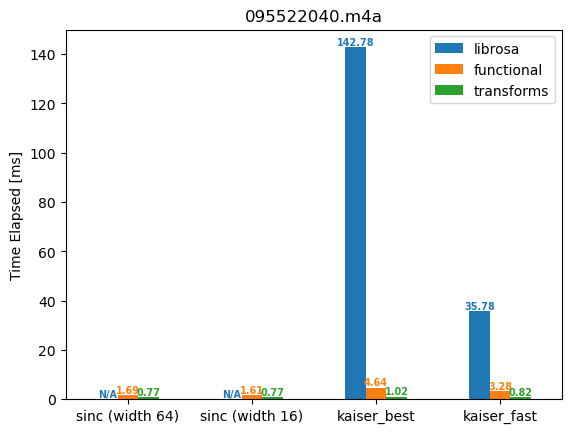

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1270757799.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522041.m4a (orig_sr=44100, target_sr=32000) ===
                 librosa  functional  transforms
sinc (width 64)      NaN        3.49        1.65
sinc (width 16)      NaN        2.51        1.07
kaiser_best       130.29        6.36        1.42
kaiser_fast        31.66        3.21        0.85


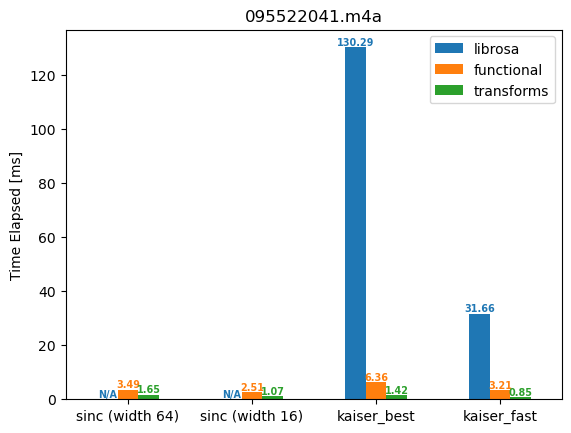

C:\Users\Public\Documents\ESTsoft\CreatorTemp\ipykernel_19792\1270757799.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(path, sr=None, mono=True)
c:\Users\user\anaconda3\Lib\site-packages\librosa\core\audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



=== 095522042.m4a (orig_sr=44100, target_sr=32000) ===
                 librosa  functional  transforms
sinc (width 64)      NaN        1.94        0.95
sinc (width 16)      NaN        1.46        0.86
kaiser_best       114.92        5.82        1.22
kaiser_fast        35.75        4.14        0.85


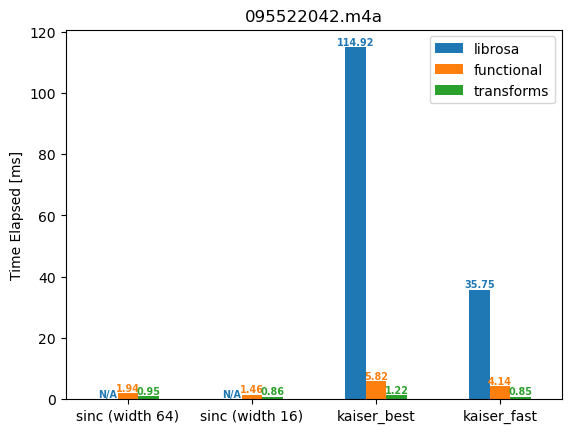

In [ ]:
pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)


def benchmark_resample_functional(
    waveform,
    sample_rate,
    resample_rate,
    lowpass_filter_width=6,
    rolloff=0.99,
    resampling_method="sinc_interp_hann",
    beta=None,
    iters=5,
):
    return (
        timeit.timeit(
            stmt="""
torchaudio.functional.resample(
    waveform,
    sample_rate,
    resample_rate,
    lowpass_filter_width=lowpass_filter_width,
    rolloff=rolloff,
    resampling_method=resampling_method,
    beta=beta,
)
            """,
            setup="import torchaudio",
            number=iters,
            globals=locals(),
        )
        * 1000
        / iters
    )

def benchmark_resample_transforms(
    waveform,
    sample_rate,
    resample_rate,
    lowpass_filter_width=6,
    rolloff=0.99,
    resampling_method="sinc_interp_hann",
    beta=None,
    iters=5,
):
    return (
        timeit.timeit(
            stmt="resampler(waveform)",
            setup="""
import torchaudio
resampler = torchaudio.transforms.Resample(
    sample_rate,
    resample_rate,
    lowpass_filter_width=lowpass_filter_width,
    rolloff=rolloff,
    resampling_method=resampling_method,
    dtype=waveform.dtype,
    beta=beta,
)
resampler.to(waveform.device)
            """,
            number=iters,
            globals=locals(),
        )
        * 1000
        / iters
    )

def benchmark_resample_librosa(
    waveform,
    sample_rate,
    resample_rate,
    res_type=None,
    iters=5,
):
    waveform_np = waveform.squeeze().numpy()
    return (
        timeit.timeit(
            stmt="""
librosa.resample(
    waveform_np,
    orig_sr=sample_rate,
    target_sr=resample_rate,
    res_type=res_type,
)
            """,
            setup="import librosa",
            number=iters,
            globals=locals(),
        )
        * 1000
        / iters
    )


def benchmark(waveform, sample_rate, resample_rate):
    times, rows = [], []
    args = (waveform, sample_rate, resample_rate)

    # sinc 64 zero-crossings
    f_time = benchmark_resample_functional(*args, lowpass_filter_width=64)
    t_time = benchmark_resample_transforms(*args, lowpass_filter_width=64)
    times.append([None, f_time, t_time])
    rows.append("sinc (width 64)")

    # sinc 16 zero-crossings  (주석과 코드 정합성만 맞춤)
    f_time = benchmark_resample_functional(*args, lowpass_filter_width=16)
    t_time = benchmark_resample_transforms(*args, lowpass_filter_width=16)
    times.append([None, f_time, t_time])
    rows.append("sinc (width 16)")

    # kaiser best
    kwargs = {
        "lowpass_filter_width": 64,
        "rolloff": 0.9475937167399596,
        "resampling_method": "sinc_interp_kaiser",
        "beta": 14.769656459379492,
    }
    lib_time = benchmark_resample_librosa(*args, res_type="kaiser_best")
    f_time = benchmark_resample_functional(*args, **kwargs)
    t_time = benchmark_resample_transforms(*args, **kwargs)
    times.append([lib_time, f_time, t_time])
    rows.append("kaiser_best")

    # kaiser fast
    kwargs = {
        "lowpass_filter_width": 16,
        "rolloff": 0.85,
        "resampling_method": "sinc_interp_kaiser",
        "beta": 8.555504641634386,
    }
    lib_time = benchmark_resample_librosa(*args, res_type="kaiser_fast")
    f_time = benchmark_resample_functional(*args, **kwargs)
    t_time = benchmark_resample_transforms(*args, **kwargs)
    times.append([lib_time, f_time, t_time])
    rows.append("kaiser_fast")

    df = pd.DataFrame(times, columns=["librosa", "functional", "transforms"], index=rows)
    return df

def plot(df, title=None):
    print(df.round(2))
    ax = df.plot(kind="bar")
    if title: ax.set_title(title)
    plt.ylabel("Time Elapsed [ms]")
    plt.xticks(rotation=0, fontsize=10)
    for cont, col, color in zip(ax.containers, df.columns, mcolors.TABLEAU_COLORS):
        label = ["N/A" if v != v else str(v) for v in df[col].round(2)]
        ax.bar_label(cont, labels=label, color=color, fontweight="bold", fontsize="x-small")
    plt.show()


DATA = r"C:\Users\user\Desktop\RAK_AI\audio_dataset"
FILES = [f"0955220{i}.m4a" for i in range(39, 43)]
TARGET_SR = 32000

for f in FILES:
    path = fr"{DATA}\{f}"
    y, sr = librosa.load(path, sr=None, mono=True)
    wav = torch.from_numpy(y).unsqueeze(0).to(torch.float32)
    print(f"\n=== {f} (orig_sr={sr}, target_sr={TARGET_SR}) ===")
    df = benchmark(wav, sr, TARGET_SR)
    plot(df, title=f)
